# Hierarchical Clustering

### Data Mining Project 2024/25

Authors: Nicola Emmolo, Simone Marzeddu, Jacopo Raffi

In [25]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [26]:
import pandas as pd
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram, cophenet
from sklearn.preprocessing import StandardScaler

import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
import numpy as np
from scipy.cluster.hierarchy import fcluster

import itertools

import warnings
warnings.filterwarnings('ignore')

In [27]:
def plot_variable_pairs(columns_to_use, dataset):
    # Creazione di tutte le combinazioni di coppie di variabili
    pairs = list(itertools.combinations(columns_to_use, 2))
    n_pairs = len(pairs)

    # Dimensione della griglia (calcolata in base al numero di coppie)
    n_cols = 2  # Numero di colonne nella griglia
    n_rows = int(np.ceil(n_pairs / n_cols))  # Numero di righe nella griglia

    # Creazione della griglia di subplot
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(10, 5 * n_rows))

    # Se c'è una sola riga di subplot, axes sarà un array 1D; uniformiamo la struttura.
    if n_rows == 1:
        axes = axes[np.newaxis, :]

    # Plot per ogni coppia di variabili
    for (x_var, y_var), ax in zip(pairs, axes.ravel()):
        sns.scatterplot(
            data=dataset,
            x=x_var, y=y_var, hue="cluster", palette="viridis", ax=ax, s=10
        )
        ax.set_title(f'Clusters: {x_var} vs {y_var}')
        ax.legend()

    # Rimuovi subplot vuoti se n_pairs non riempie la griglia
    for ax in axes.ravel()[n_pairs:]:
        fig.delaxes(ax)

    plt.tight_layout()
    plt.show()

In [28]:
def plot_variable_triplets(columns_to_use, dataset):
    # Creazione di tutte le combinazioni di triplette di variabili
    triplets = list(itertools.combinations(columns_to_use, 3))
    n_triplets = len(triplets)

    # Dimensione della griglia (calcolata in base al numero di triplette)
    n_cols = 2  # Numero di colonne nella griglia
    n_rows = int(np.ceil(n_triplets / n_cols))  # Numero di righe nella griglia

    # Creazione della griglia di subplot
    fig = plt.figure(figsize=(14, 7 * n_rows))


    # Plot per ogni combinazione di tre variabili
    for i, (x_var, y_var, z_var) in enumerate(triplets):
        ax = fig.add_subplot(n_rows, n_cols, i + 1, projection='3d')

        # Scatterplot dei dati
        ax.scatter(
            dataset[x_var],
            dataset[y_var],
            dataset[z_var],
            c=dataset["cluster"], cmap="viridis", s=10, zorder=1
        )

        # Titolo e etichette
        ax.set_title(f'Clusters: {x_var} vs {y_var} vs {z_var}', pad=20)
        ax.set_xlabel(x_var)
        ax.set_ylabel(y_var)
        ax.set_zlabel(z_var)

    # Imposta layout per evitare sovrapposizioni
    plt.tight_layout()
    plt.show()

In [29]:
races_dataset = pd.read_csv('../../data/races_dataset_no_outliers.csv').drop(['uci_points', 'profile'], axis=1)
races_dataset = races_dataset.select_dtypes(include=['number'])
races_dataset = races_dataset.dropna().reset_index(drop=True)

# drop colums from PCA and UMAP analisis
races_dataset = races_dataset.drop(['startlist_quality', 'race_year', 'climb_percentage'], axis=1)

races_dataset.info()
columns_to_use = races_dataset.columns

# Standardizzazione dei dati
scaler = StandardScaler()
data_scaled = scaler.fit_transform(races_dataset)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2841 entries, 0 to 2840
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   points                2841 non-null   float64
 1   length                2841 non-null   float64
 2   climb_total           2841 non-null   float64
 3   race_physical_effort  2841 non-null   float64
 4   race_prestige         2841 non-null   float64
 5   num_participants      2841 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 133.3 KB


## Complete

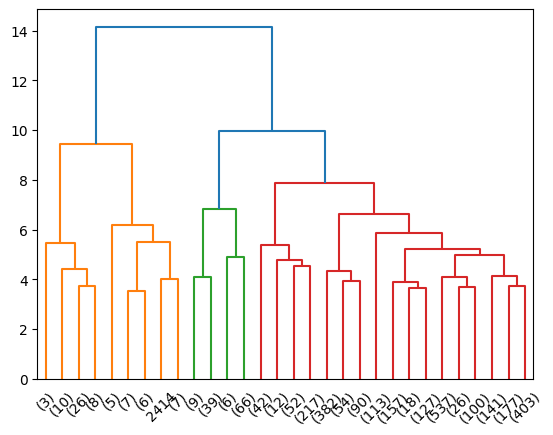

In [30]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='complete', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [31]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.7806861322044526)

In [32]:
cluster_labels = fcluster(data_link, t=9, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.3824509615972317)

### 2D

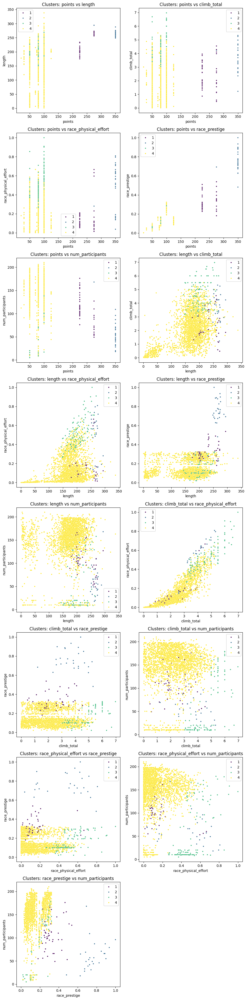

In [33]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

- Cluster viola -> gare lunghe ad alto prestigio;
- Cluster giallo -> gare di basso prestigio che richiedono poco sforzo fisico;
- Cluster Verde -> gare di basso prestigio che richiedono molto sforzo fisico;

### 3D

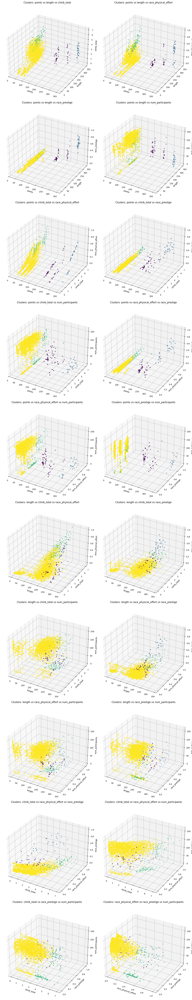

In [34]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)

## Single

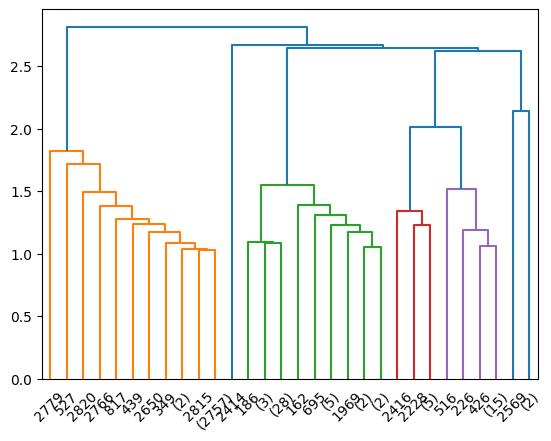

In [35]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='single', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [36]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.6730426544087956)

In [37]:
cluster_labels = fcluster(data_link, t=2.8, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.5998964773658901)

### 2D

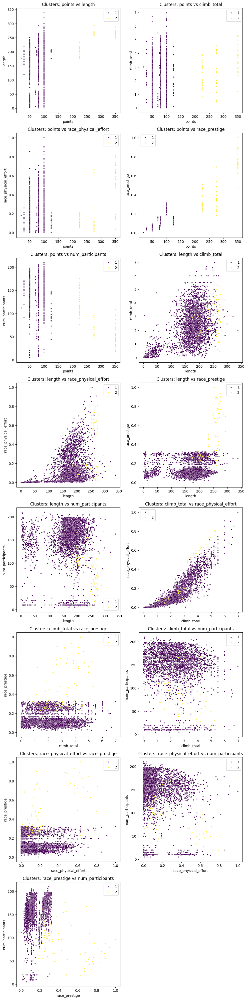

In [38]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

Clustering peggiore rispetto al metodo "complete". Un cluster contiene un solo punto (può darsi che sia dovuto a outlier).

Il cluster viola rappresenta alto prestigio e alto physical_effort, il cluster verde sostanzialmente tutto il resto.

### 3D

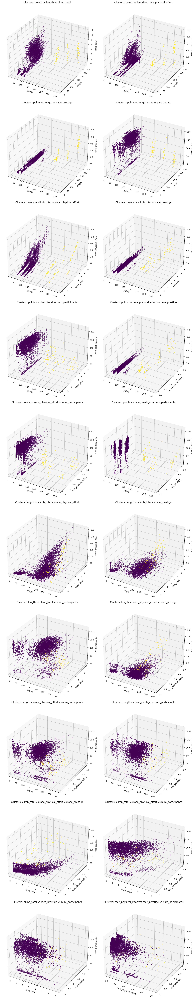

In [39]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)

## Average

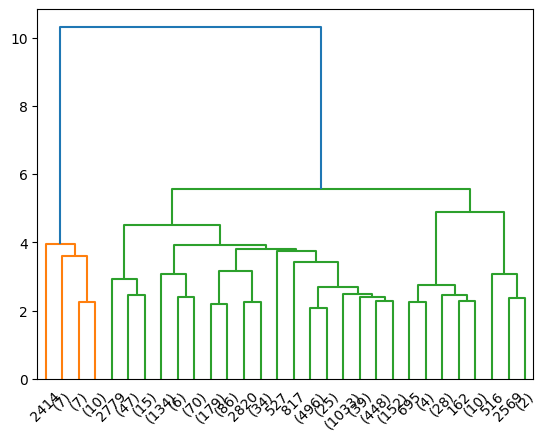

In [40]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='average', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [41]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.8638198806214112)

In [42]:
cluster_labels = fcluster(data_link, t=6, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.7114711291551064)

### 2D

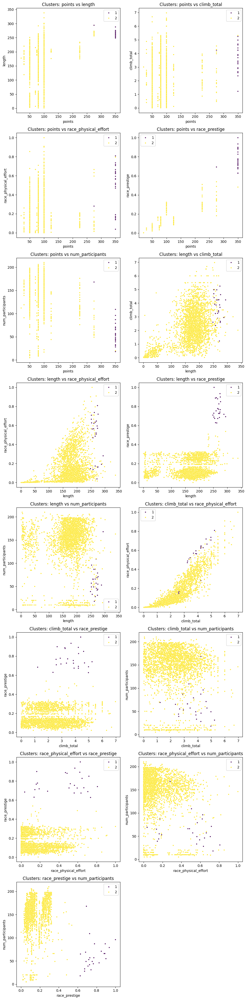

In [43]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

Metodo "Average" sembra più preciso rispetto ai due precedenti.

- Cluster viola -> basso prestigio, poca lunghezza e poco physical_effort;
- Cluster giallo -> medio-alto prestigio e molta lunghezza ma poco sforzo fisico;
- Cluster verde -> Gare molto impegnative molto lunghe, richiedono molto sforzo fisico e hanno anche un elevato prestigio;
- Cluster blu chiaro -> gare impegnative a medio-basso prestigio ma allo stesso tempo brevi;
- Cluster blu scuro -> gare a basso prestigio (lunghezza media e sforzo fisico variabile).

### 3D

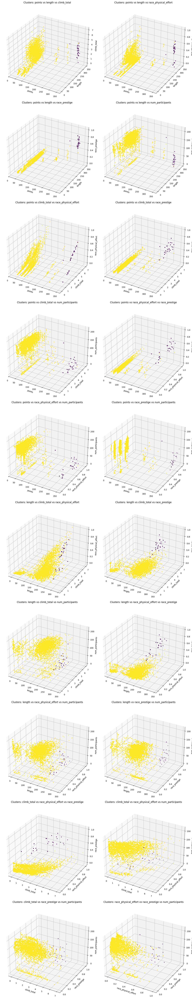

In [44]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)

## Ward

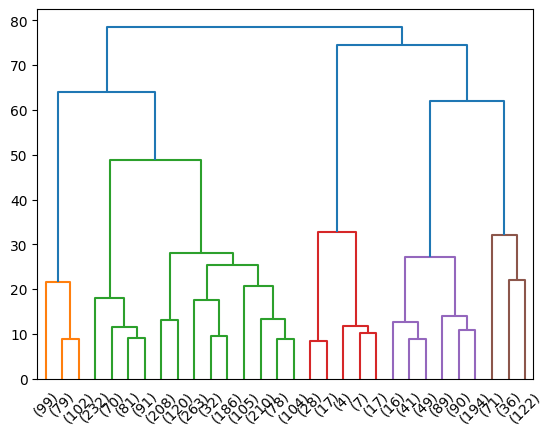

In [45]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='ward', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [46]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.5952483644680285)

In [47]:
cluster_labels = fcluster(data_link, t=70, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.29472603419576304)

### 2D

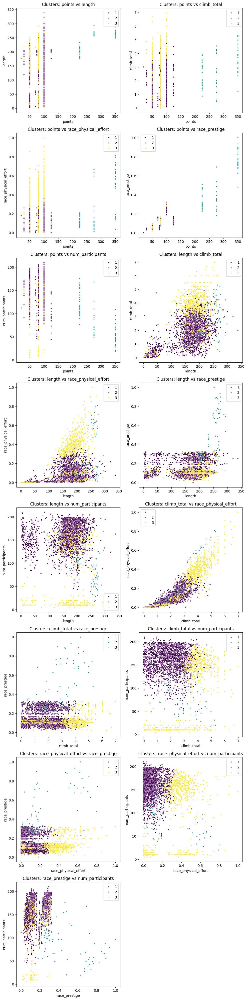

In [48]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

- Cluster giallo -> gare lunghe e ad alto prestigio con sforzo fisico variabile;
- Cluster viola -> gare brevi e semplici con basso prestigio;
- Cluster blu -> gare con basso prestigio e lunghezza media ma che richiedono un notevole sforzo fisico;
- Cluster verde -> gare di lunghezza media alta ma con poco prestigio e poco sforzo fisico.

### 3D

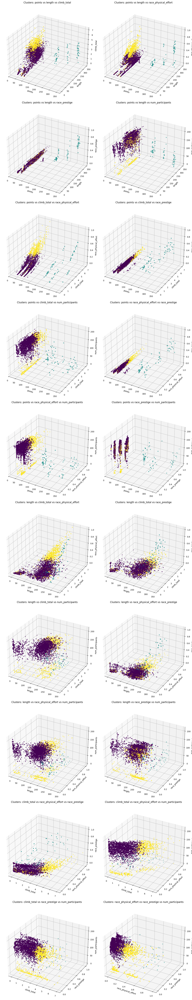

In [49]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)